In [1]:
from functions import *
import pandas as pd
from sklearn.model_selection import train_test_split
from gensim.models import Phrases
from gensim.models.phrases import Phraser
import spacy
from spacy.lang.es.examples import sentences 
from gensim.models.ldamodel import LdaModel
import gensim.corpora as corpora
from gensim.models import CoherenceModel
import matplotlib.pyplot as plt
from wordcloud import WordCloud

c:\Users\franc\AppData\Local\Programs\Python\Python310\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Split de data
Separar la data en una distribucion de 70%, 15%, 15% para entrenamiento, prueba y validación

In [2]:
df = pd.read_csv('./data/data_wiki.csv')
total_train, test = train_test_split(df, train_size=0.85,  random_state=2022)
train, validation = train_test_split(total_train, train_size=0.828969415701948)

# Generar modelo

In [3]:
# Generate mods -45 seconds
wiki_words = sentences_to_words(train.parrafo.tolist())
bigram_mod = generate_bigram_mod(wiki_words)
trigram_mod = generate_trigram_mod(wiki_words)

In [4]:
# Generate bigrams and trigrams 30 seconds
wiki_words_no_stopwords = remove_stopwords(wiki_words)
bigrams  = make_bigrams(wiki_words_no_stopwords, bigram_mod)
trigrams = make_trigrams(wiki_words_no_stopwords, bigram_mod, trigram_mod)

In [5]:
bi_lematizacion = lemmatization(bigrams)

In [6]:
bi_lematizacion

[['banda',
  'punk',
  'formado',
  'considerado',
  'fuente',
  'responsable',
  'iniciar',
  'movimiento',
  'punk',
  'reino_unido',
  'inspirar',
  'musico',
  'heavy_metal',
  'rock',
  'contemporaneo',
  'general',
  'ano',
  'medio',
  'producir',
  'unicamente',
  'sencillo',
  'album',
  'estudio',
  'herir',
  'miembro',
  'originalmente',
  'vocalista',
  'johnny_rottir',
  'guitarrista',
  'bajista',
  'glir',
  'ultimo',
  'reemplazado',
  'sid_vicious',
  'principio',
  'empresario',
  'banda',
  'protagonacer',
  'escandalo',
  'convertir',
  'centro',
  'atencion',
  'opinion_publico',
  'britanico',
  'letra',
  'fuerte',
  'contenido',
  'satirico',
  'concierto',
  'frecuentemente',
  'topar',
  'dificultad',
  'organizador',
  'autoridad',
  'apariciones_publica',
  'menudo',
  'acabar',
  'cao',
  'sencillo',
  'atacar',
  'conformismo',
  'social',
  'inglés',
  'respetar',
  'corona',
  'precipito',
  'ultimo',
  'mayor',
  'ola',
  'pandemonio',
  'moral',
  'ba

In [7]:
id2word  = corpora.Dictionary(bi_lematizacion)
corpus = [id2word.doc2bow(text) for text in bi_lematizacion]

In [28]:
lda_model = LdaModel(
    corpus=corpus,
    id2word=id2word,
    num_topics=10, 
    random_state=100,
    update_every=1,
    chunksize=50,
    passes=10,
    alpha= 'auto',
    # beta=1,
    per_word_topics=True
)

In [29]:
lda_model.print_topics()


[(0,
  '0.013*"ciudad" + 0.008*"ano" + 0.005*"primero" + 0.005*"encontrar" + 0.004*"zona" + 0.004*"nuevo" + 0.004*"contar" + 0.003*"centro" + 0.003*"mas" + 0.003*"mayor"'),
 (1,
  '0.012*"egipcio" + 0.011*"griego" + 0.010*"medico" + 0.008*"dios" + 0.007*"heracl" + 0.007*"papiro" + 0.007*"faraon" + 0.006*"culto" + 0.005*"diós" + 0.005*"odin"'),
 (2,
  '0.015*"obra" + 0.006*"arte" + 0.004*"primero" + 0.004*"autor" + 0.004*"estilo" + 0.004*"forma" + 0.004*"nuevo" + 0.004*"gran" + 0.003*"artista" + 0.003*"epocar"'),
 (3,
  '0.007*"politico" + 0.006*"presidente" + 0.006*"ley" + 0.005*"partido" + 0.005*"gobierno" + 0.005*"pais" + 0.004*"militar" + 0.004*"rumano" + 0.004*"nuevo" + 0.003*"frente"'),
 (4,
  '0.005*"ejercito" + 0.005*"hacer" + 0.004*"batalla" + 0.004*"hombre" + 0.004*"guerra" + 0.003*"nuevo" + 0.003*"embargo" + 0.003*"primero" + 0.003*"ciudad" + 0.003*"habio"'),
 (5,
  '0.008*"esparto" + 0.008*"pericl" + 0.006*"aspasio" + 0.004*"ateniense" + 0.003*"espartán" + 0.003*"espartano" 

In [30]:
lda_model.alpha

array([0.8109916 , 0.04693064, 0.6002164 , 0.25061655, 0.65216506,
       0.00493114, 0.06115546, 0.6991117 , 0.11711599, 0.28169626],
      dtype=float32)

In [31]:
coherence_model_lda = CoherenceModel(model=lda_model, texts=bi_lematizacion, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Coherence Score:  0.5009703225174278


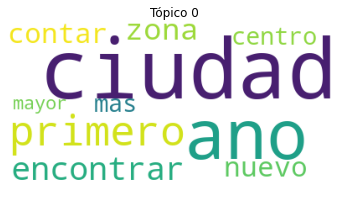

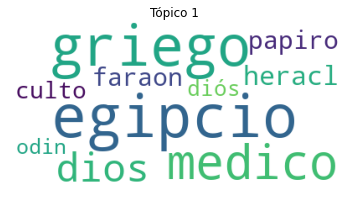

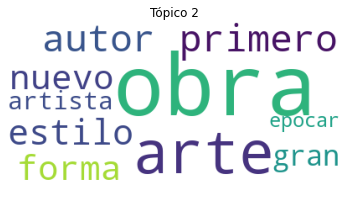

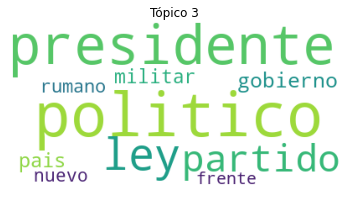

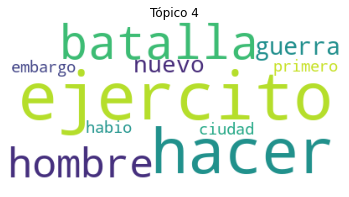

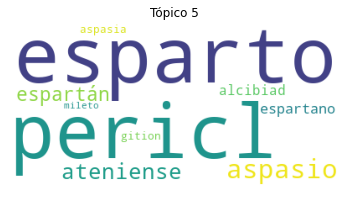

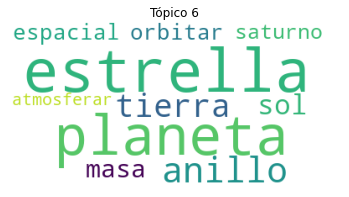

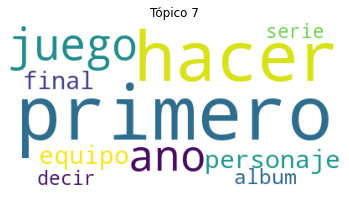

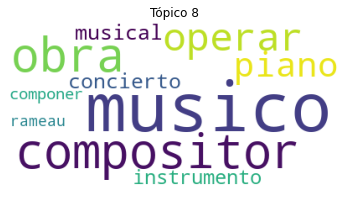

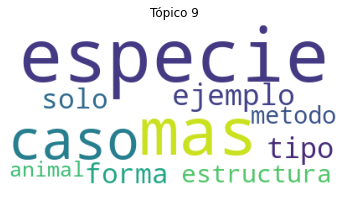

In [32]:
for i in range(0, len(lda_model.alpha)):
    plt.figure()
    plt.imshow(WordCloud(background_color='white', prefer_horizontal=1.0).fit_words(dict(lda_model.show_topic(i, 10))))
    plt.axis("off")
    plt.title("Tópico " + str(i))
    plt.show()

# Test data

In [39]:
test_article = test.parrafo.tolist()[1]

In [40]:
#test_article = "El inmueble ampliará las instalaciones actuales de Tigo en Guatemala, situadas en el kilómetro 10 de la carretera que conduce a El Salvador, según explicó en un comunicado de prensa la firma constructora Grupo PreCon, a cargo del proyecto. La construcción empezó el pasado mes de diciembre y culminará, en una fase preliminar, en noviembre, cuando PreCon entregue el edificio terminado y con las instalaciones hidráulicas y eléctricas completadas, añadió la fuente.  La inauguración de la edificación está programada para el próximo año. La firma constructora utilizará 1 mil 970 metros cuadrados de cemento para el levantamiento del bloque, lo que equivale “a la fundición más grande de la ”, de acuerdo al encargado del proyecto del Grupo PreCon, Danilo Perla. Alrededor de 200 trabajadores han sido contratados para la construcción del inmueble, que tendrá veinte pisos, incluidos seis niveles con capacidad para aparcar 800 automóviles y un área de exposiciones de 400 metros cuadrados."

<AxesSubplot:xlabel='Tema'>

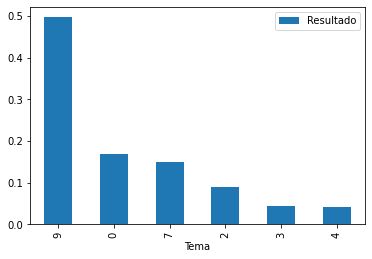

In [41]:
test_words = sentences_to_words([test_article])
tests_words_nostops = remove_stopwords(test_words)
tests_words_bigrams = make_bigrams(tests_words_nostops, bigram_mod)
tests_words_bow = [id2word.doc2bow(text) for text in tests_words_bigrams]
topic_result = lda_model.get_document_topics(tests_words_bow[0])
plot_subject(topic_result)

In [42]:
topic_result

[(0, 0.16846347),
 (2, 0.09076827),
 (3, 0.044083208),
 (4, 0.042707566),
 (7, 0.14988087),
 (9, 0.4965802)]

In [ ]:
# Check text of article
test_article

# Conclusiones

1. Interpretación de los temas generados:
Los tópicos generados 
2. ¿Qué arroja su modelo sobre textos cuyo contenido les es conocido?
